# Spotify Dataset Analysis for K-Means Clustering

In [3]:
from kagglehub import dataset_download
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import pandas as pd
from pathlib import Path
from sklearn.feature_selection import f_classif, mutual_info_classif
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.decomposition import PCA
import seaborn as sns
import math


In [4]:
kaggle_dataset_id = "solomonameh/spotify-music-dataset"
root = Path(dataset_download(kaggle_dataset_id))
csv_files = sorted(root.rglob("*.csv"))
frame = pd.concat((pd.read_csv(csv_file) for csv_file in csv_files), ignore_index=True)
frame.head()

100%|██████████| 573k/573k [00:00<00:00, 70.5MB/s]

Extracting files...


,energy,tempo,danceability,playlist_genre,loudness,liveness,valence,track_artist,time_signature,speechiness,...,instrumentalness,track_album_id,mode,key,duration_ms,acousticness,id,playlist_subgenre,type,playlist_id
0,0.592,157.969,0.521,pop,-7.777,0.122,0.535,"Lady Gaga, Bruno Mars",3.0,0.0304,...,0.0000,10FLjwfpbxLmW8c25Xyc2N,0.0,6.0,251668.0,0.3080,2plbrEY59IikOBgBGLjaoe,mainstream,audio_features,37i9dQZF1DXcBWIGoYBM5M
1,0.507,104.978,0.747,pop,-10.171,0.117,0.438,Billie Eilish,4.0,0.0358,...,0.0608,7aJuG4TFXa2hmE4z1yxc3n,1.0,2.0,210373.0,0.2000,6dOtVTDdiauQNBQEDOtlAB,mainstream,audio_features,37i9dQZF1DXcBWIGoYBM5M
2,0.808,108.548,0.554,pop,-4.169,0.159,0.372,Gracie Abrams,4.0,0.0368,...,0.0000,0hBRqPYPXhr1RkTDG3n4Mk,1.0,1.0,166300.0,0.2140,7ne4VBA60CxGM75vw0EYad,mainstream,audio_features,37i9dQZF1DXcBWIGoYBM5M
3,0.910,112.966,0.670,pop,-4.070,0.304,0.786,Sabrina Carpenter,4.0,0.0634,...,0.0000,4B4Elma4nNDUyl6D5PvQkj,0.0,0.0,157280.0,0.0939,1d7Ptw3qYcfpdLNL5REhtJ,mainstream,audio_features,37i9dQZF1DXcBWIGoYBM5M
4,0.783,149.027,0.777,pop,-4.477,0.355,0.939,"ROSÉ, Bruno Mars",4.0,0.2600,...,0.0000,2IYQwwgxgOIn7t3iF6ufFD,0.0,0.0,169917.0,0.0283,5vNRhkKd0yEAg8suGBpjeY,mainstream,audio_features,37i9dQZF1DXcBWIGoYBM5M


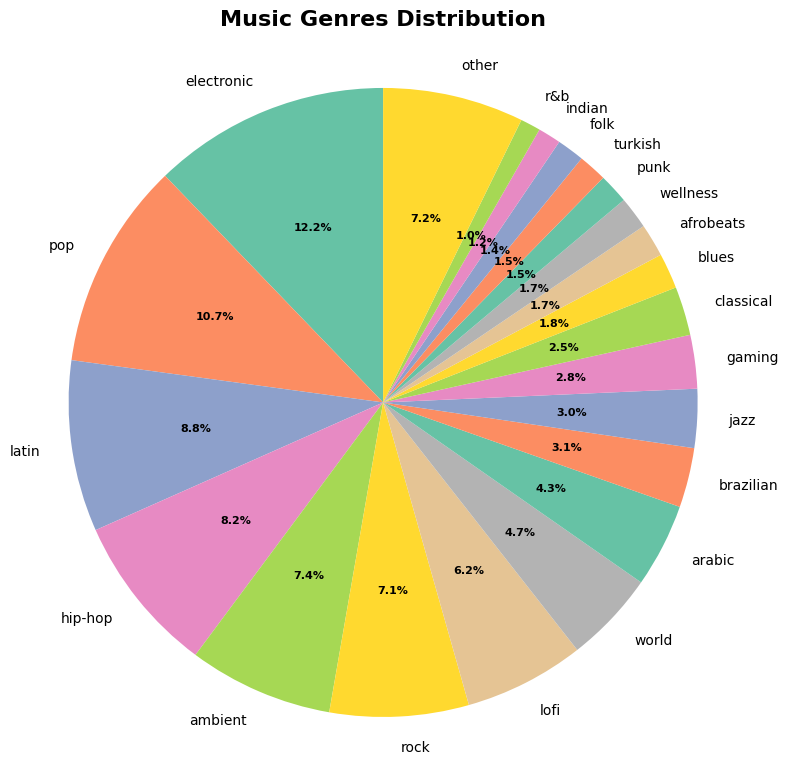

Total number of songs: 4831
Number of unique genres: 35

Top 10 genres:
playlist_genre
electronic    589
pop           515
latin         425
hip-hop       395
ambient       359
rock          345
lofi          299
world         228
arabic        208
brazilian     148
Name: count, dtype: int64


In [5]:
plt.figure(figsize=(8, 8))

genre_counts = frame['playlist_genre'].value_counts()

top_n = 21
if len(genre_counts) > top_n:
    top_genres = genre_counts.head(top_n)
    other_count = genre_counts[top_n:].sum()
    top_genres['other'] = other_count
    data = top_genres
else:
    data = genre_counts

colors = plt.cm.Set3(
    np.linspace(
        0,
        1,
        len(data)
        )
    )
wedges, texts, autotexts = plt.pie(
    data.values,
    labels=data.index,
    autopct='%1.1f%%',
    colors=sns.color_palette("Set2", top_n + 1),
    startangle=90
  )

plt.setp(autotexts, size=8, weight="bold")
plt.setp(texts, size=10)

plt.title(
    'Music Genres Distribution',
    fontsize=16,
    fontweight='bold'
    )

plt.axis('equal')

#if len(data) > 5:
#    plt.legend(wedges,
#               data.index,
#               title="Genres",
#               loc="upper left",
#               bbox_to_anchor=(1, 0, 0.5, 1)
#               )

plt.tight_layout()
plt.show()

print(f"Total number of songs: {len(frame)}")
print(f"Number of unique genres: {len(frame['playlist_genre'].value_counts())}")
print("\nTop 10 genres:")
print(frame['playlist_genre'].value_counts().head(10))


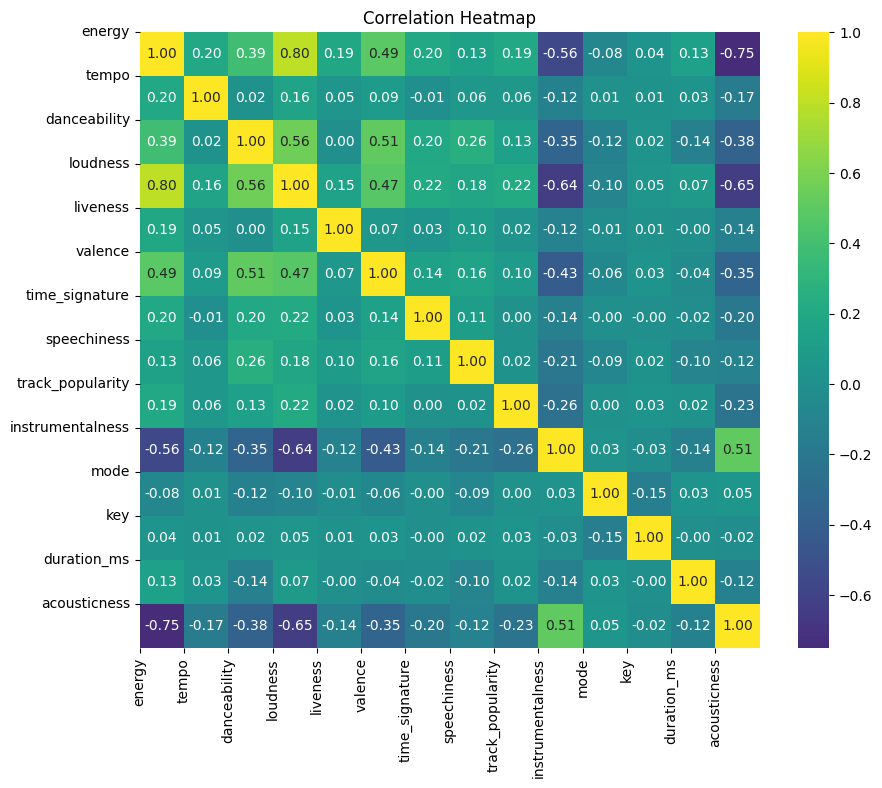

In [6]:
numeric = frame.select_dtypes(include=np.number)
correlations = numeric.corr()
plt.figure(figsize=(10,8))

sns.heatmap(correlations, annot=True, cmap='viridis', center=0, fmt=".2f")

cols: list[str] = [col for col in correlations.columns]
plt.xticks(ticks=np.arange(len(cols)), labels=cols, rotation=90)
plt.yticks(ticks=np.arange(len(cols)), labels=cols)
plt.title('Correlation Heatmap')

plt.show()

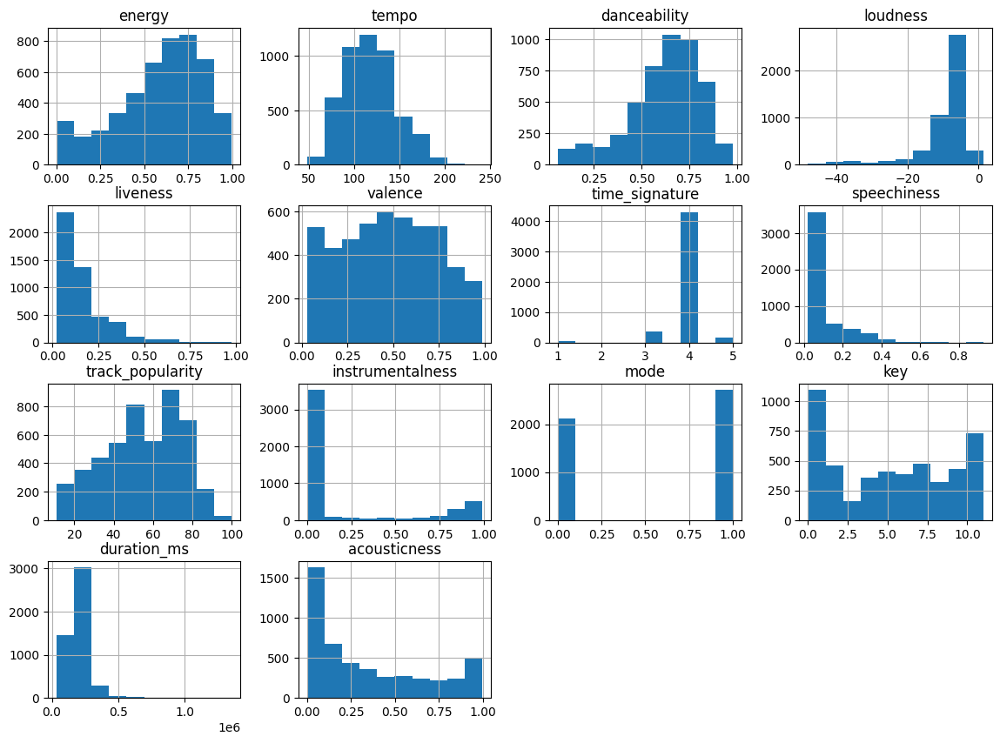

In [7]:
numeric.hist(figsize=(14,10))
plt.show()

In [14]:
percentiles = numeric.quantile([0.25, 0.5, 0.75]).T
percentiles.columns = ["Q1", "Q2", "Q3"]

central = pd.DataFrame({
    "Mean": numeric.mean(),
    "Mode": numeric.mode().iloc[0],
})

spread = pd.DataFrame({
    "Range": numeric.max() - numeric.min(),
    "Variance": numeric.var(),
})

stats_summary = pd.concat([percentiles, central, spread], axis=1)

stats_summary.to_latex(float_format="%.2f")

'\\begin{tabular}{lrrrrrrr}\n\\toprule\n & Q1 & Q2 & Q3 & Mean & Mode & Range & Variance \\\\\n\\midrule\nenergy & 0.44 & 0.63 & 0.78 & 0.59 & 0.66 & 1.00 & 0.06 \\\\\ntempo & 96.06 & 118.06 & 136.72 & 118.27 & 119.99 & 193.19 & 812.97 \\\\\ndanceability & 0.53 & 0.65 & 0.76 & 0.62 & 0.67 & 0.92 & 0.04 \\\\\nloudness & -10.30 & -7.19 & -5.34 & -9.28 & -5.49 & 49.39 & 50.83 \\\\\nliveness & 0.10 & 0.12 & 0.20 & 0.17 & 0.11 & 0.96 & 0.02 \\\\\nvalence & 0.28 & 0.48 & 0.69 & 0.48 & 0.53 & 0.96 & 0.07 \\\\\ntime_signature & 4.00 & 4.00 & 4.00 & 3.94 & 4.00 & 4.00 & 0.17 \\\\\nspeechiness & 0.04 & 0.06 & 0.12 & 0.10 & 0.03 & 0.91 & 0.01 \\\\\ntrack_popularity & 41.00 & 56.00 & 72.00 & 54.76 & 68.00 & 89.00 & 393.17 \\\\\ninstrumentalness & 0.00 & 0.00 & 0.20 & 0.20 & 0.00 & 0.99 & 0.12 \\\\\nmode & 0.00 & 1.00 & 1.00 & 0.56 & 1.00 & 1.00 & 0.25 \\\\\nkey & 2.00 & 5.00 & 8.00 & 5.23 & 1.00 & 11.00 & 12.82 \\\\\nduration_ms & 159000.00 & 194866.50 & 233478.00 & 206150.82 & 144000.00 & 1319885

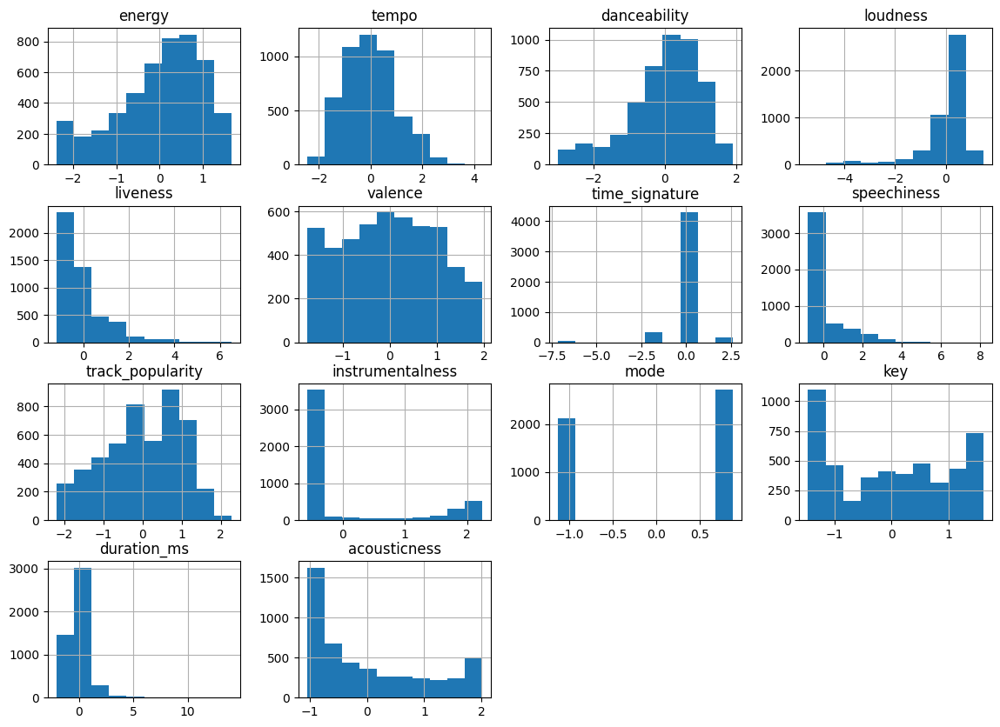

In [17]:

X_sanitized = numeric.dropna()
scaler = StandardScaler()
scaled_features = scaler.fit_transform(X_sanitized)
X_scaled = pd.DataFrame(scaled_features, index=X_sanitized.index, columns=X_sanitized.columns)
X_scaled.hist(figsize=(14,10))
plt.show()

In [ ]:
component_count = 14

X_sanitized = numeric.dropna()
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_sanitized)

pca = PCA(n_components=component_count)
X_pca = pca.fit_transform(X_scaled)

In [ ]:
scaled_features = StandardScaler().fit_transform(X_sanitized)
scaled_features

array([[ 0.02156025,  1.39250002, -0.53978875, ...,  0.21412361,
         0.55687302, -0.10209663],
       [-0.32363553, -0.46620308,  0.66434866, ..., -0.90304305,
         0.05165564, -0.43404849],
       [ 0.89876363, -0.34098238, -0.36396338, ..., -1.18233471,
        -0.48754876, -0.39101769],
       ...,
       [ 0.03374363,  1.96560394, -0.99267229, ..., -0.62375138,
         3.27010875,  1.45930657],
       [ 0.01749912,  1.98145822, -0.71028609, ...,  0.77270694,
         1.13579011,  1.86502552],
       [ 0.93125265,  1.84739841, -1.87712721, ...,  0.77270694,
         5.3776097 ,  1.57303082]])

In [ ]:
X_scaled = pd.DataFrame(scaled_features, index=X_sanitized.index, columns=X_sanitized.columns)
X_scaled

,energy,tempo,danceability,loudness,liveness,valence,time_signature,speechiness,track_popularity,instrumentalness,mode,key,duration_ms,acousticness
0,0.021560,1.392500,-0.539789,0.211067,-0.366617,0.205692,-2.286347,-0.706173,2.281463,-0.571364,-1.133000,0.214124,0.556873,-0.102097
1,-0.323636,-0.466203,0.664349,-0.124760,-0.406805,-0.170263,0.154647,-0.652719,2.130165,-0.398579,0.882613,-0.903043,0.051656,-0.434048
2,0.898764,-0.340982,-0.363963,0.717193,-0.069229,-0.426068,0.154647,-0.642820,1.928435,-0.571364,0.882613,-1.182335,-0.487549,-0.391018
3,1.312999,-0.186017,0.254089,0.731081,1.096210,1.178523,0.154647,-0.379509,1.323244,-0.571364,-1.133000,-1.461626,-0.597903,-0.760160
4,0.797235,1.078852,0.824190,0.673988,1.506124,1.771524,0.154647,1.566617,2.180598,-0.571364,-1.133000,-1.461626,-0.443297,-0.961790
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4826,-0.660709,-1.501361,-1.440228,0.178523,0.597885,0.476999,-7.168333,-0.379509,-1.097519,-0.571364,0.882613,1.331290,5.568368,1.917277
4827,-0.965294,1.014523,-0.806191,-1.031242,0.951535,-0.480329,0.154647,-0.357731,-1.652278,2.114198,0.882613,0.772707,2.303106,1.948013
4828,0.033744,1.965604,-0.992672,-0.310349,-0.592471,1.504093,0.154647,-0.342883,-1.854008,1.895374,0.882613,-0.623751,3.270109,1.459307
4829,0.017499,1.981458,-0.710286,-0.219028,-0.728305,0.802569,-7.168333,-0.202318,-1.601845,2.063044,-1.133000,0.772707,1.135790,1.865026


In [ ]:
correlations = X_scaled.corr()
correlations

,energy,tempo,danceability,loudness,liveness,valence,time_signature,speechiness,track_popularity,instrumentalness,mode,key,duration_ms,acousticness
energy,1.000000,0.197656,0.387130,0.798847,0.192610,0.491667,0.196889,0.133810,0.194709,-0.564715,-0.079007,0.039787,0.125196,-0.751047
tempo,0.197656,1.000000,0.019804,0.161933,0.047019,0.088095,-0.009567,0.063921,0.059866,-0.124832,0.007742,0.013622,0.031976,-0.173084
danceability,0.387130,0.019804,1.000000,0.557794,0.000985,0.513602,0.199454,0.256236,0.128388,-0.349489,-0.122695,0.024539,-0.140718,-0.381223
loudness,0.798847,0.161933,0.557794,1.000000,0.154219,0.471230,0.217909,0.178581,0.217100,-0.641624,-0.096927,0.045583,0.070524,-0.647311
liveness,0.192610,0.047019,0.000985,0.154219,1.000000,0.067163,0.029167,0.097260,0.022258,-0.119132,-0.014222,0.007317,-0.002971,-0.136966
valence,0.491667,0.088095,0.513602,0.471230,0.067163,1.000000,0.140068,0.161457,0.096816,-0.427658,-0.062336,0.033525,-0.035969,-0.351583
time_signature,0.196889,-0.009567,0.199454,0.217909,0.029167,0.140068,1.000000,0.108594,0.003242,-0.139075,-0.003050,-0.003755,-0.018898,-0.199077
speechiness,0.133810,0.063921,0.256236,0.178581,0.097260,0.161457,0.108594,1.000000,0.019250,-0.209151,-0.087428,0.016914,-0.096539,-0.119050
track_popularity,0.194709,0.059866,0.128388,0.217100,0.022258,0.096816,0.003242,0.019250,1.000000,-0.263147,0.003091,0.029174,0.021463,-0.232679
instrumentalness,-0.564715,-0.124832,-0.349489,-0.641624,-0.119132,-0.427658,-0.139075,-0.209151,-0.263147,1.000000,0.025468,-0.025045,-0.141094,0.511612


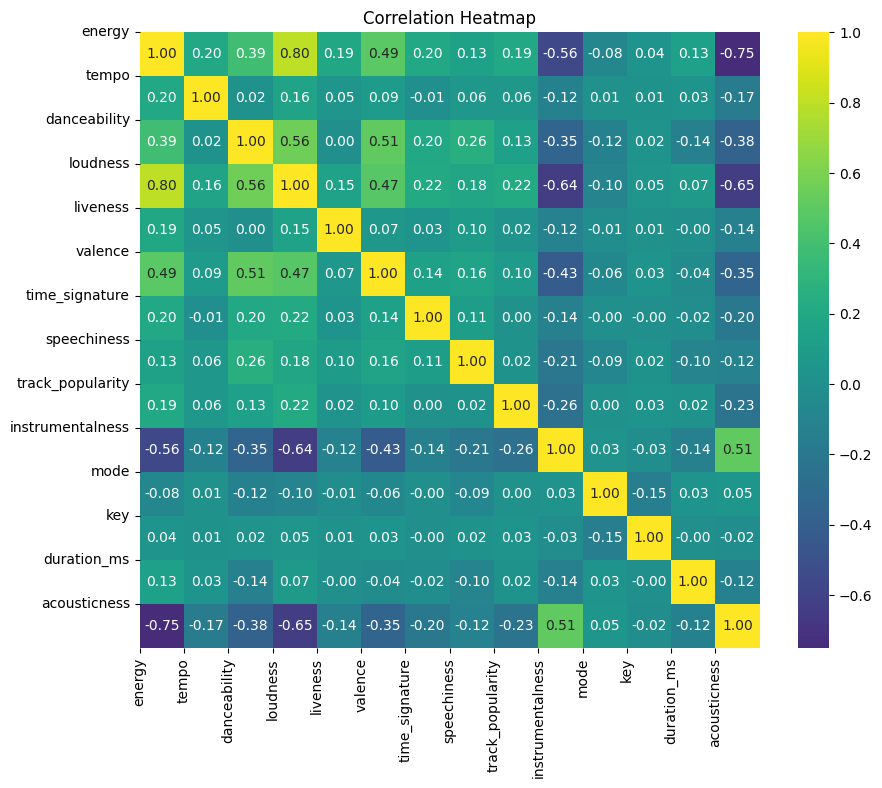

In [ ]:
plt.figure(figsize=(10,8))

sns.heatmap(correlations, annot=True, cmap='viridis', center=0, fmt=".2f")

cols: list[str] = [col for col in correlations.columns]
plt.xticks(ticks=np.arange(len(cols)), labels=cols, rotation=90)
plt.yticks(ticks=np.arange(len(cols)), labels=cols)
plt.title('Correlation Heatmap')

plt.show()

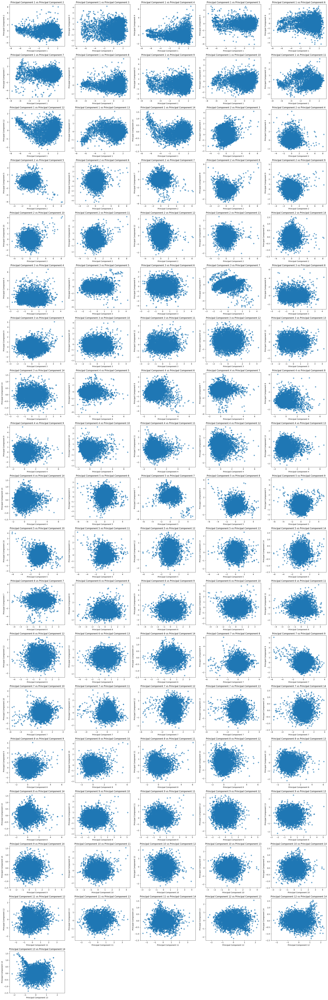

In [ ]:
pc_pairs = [(i, j) for i in range(component_count) for j in range(i+1, component_count)]
combination_count = len(pc_pairs)

cols_count = 5
rows_count = math.ceil(combination_count / cols_count)

fig, axes = plt.subplots(
    rows_count,
    cols_count,
    figsize=(
        5 * cols_count,
        4 * rows_count
        )
    )
axes = axes.flatten()

for idx, (c1, c2) in enumerate(pc_pairs):
    axes[idx].scatter(X_pca[:, c1], X_pca[:, c2], alpha=0.6)
    axes[idx].set_xlabel(f'Principal Component {c1+1}')
    axes[idx].set_ylabel(f'Principal Component {c2+1}')
    axes[idx].set_title(f'Principal Component {c1+1} vs Principal Component {c2+1}')

for j in range(len(pc_pairs), len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()


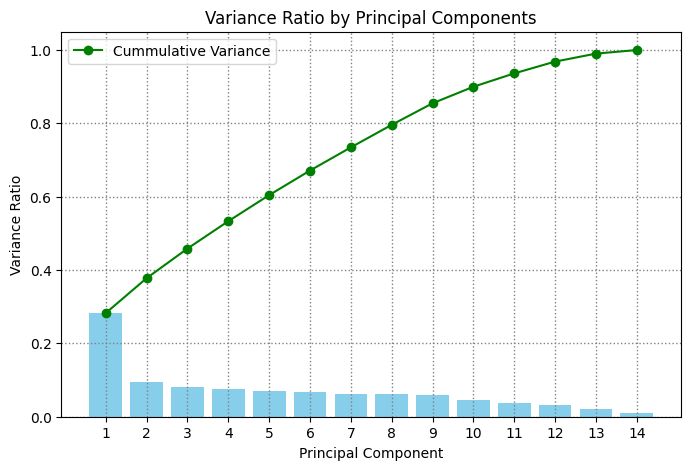

In [ ]:
plt.figure(figsize=(8,5))
plt.bar(range(1, component_count + 1), pca.explained_variance_ratio_, color='skyblue')
plt.plot(range(1, component_count + 1), pca.explained_variance_ratio_.cumsum(),
         marker='o', color='green', label='Cummulative Variance')
plt.xlabel('Principal Component')
plt.ylabel('Variance Ratio')
plt.title('Variance Ratio by Principal Components')
plt.xticks(range(1, component_count + 1))
plt.grid(color='gray', linestyle=':', linewidth=1)
plt.legend()
plt.show()


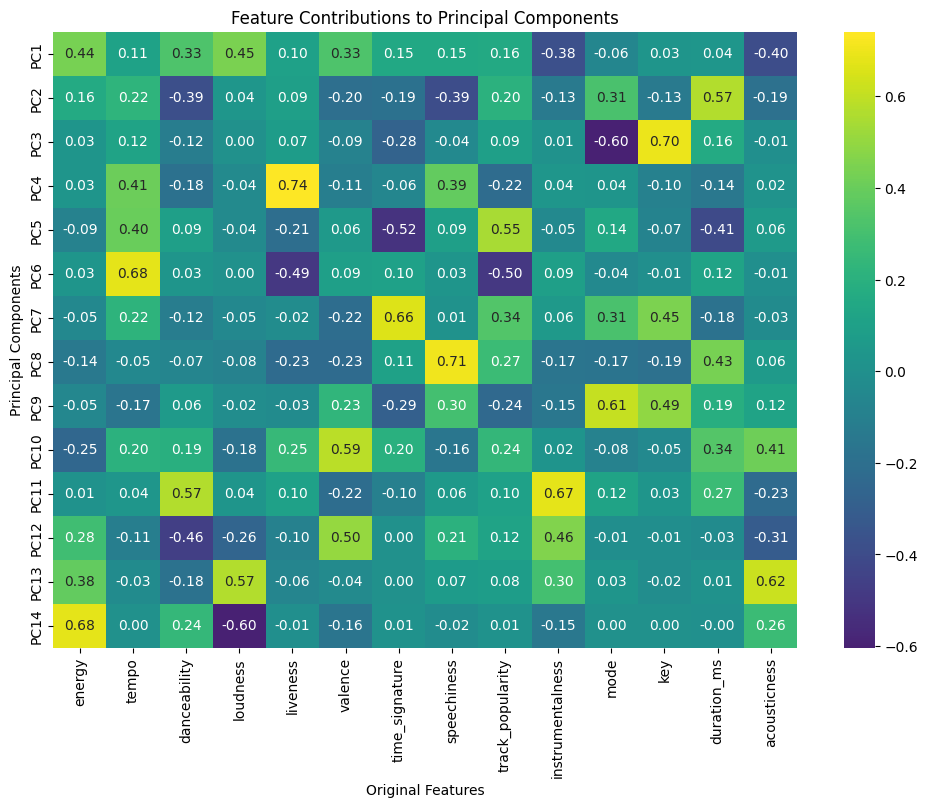

In [ ]:
loadings = pd.DataFrame(pca.components_,
                        columns=X_sanitized.columns,
                        index=[f'PC{i+1}' for i in range(component_count)])

plt.figure(figsize=(12,8))
sns.heatmap(loadings, annot=True, cmap='viridis', center=0, fmt=".2f")
plt.title('Feature Contributions to Principal Components')
plt.xlabel('Original Features')
plt.ylabel('Principal Components')
plt.show()

In [ ]:
genre_encoder = LabelEncoder()
y = genre_encoder.fit_transform(frame["playlist_genre"])

X_num = frame.select_dtypes(include=np.number).dropna()

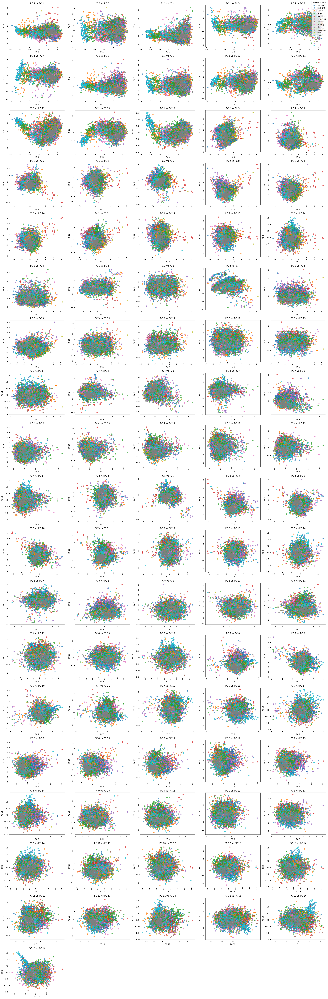

In [ ]:
genre_names = genre_encoder.classes_
y_colors = genre_encoder.transform(frame.loc[X_sanitized.index, "playlist_genre"])

pc_pairs = [(i, j) for i in range(component_count) for j in range(i+1, component_count)]
cols = 5
rows = math.ceil(len(pc_pairs) / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 4*rows))
axes = axes.flatten()

for idx, (c1, c2) in enumerate(pc_pairs):
    ax = axes[idx]
    scatter = ax.scatter(
        X_pca[:, c1],
        X_pca[:, c2],
        c=y_colors,
        cmap="tab10",
        alpha=0.7
    )
    ax.set_xlabel(f"PC {c1+1}")
    ax.set_ylabel(f"PC {c2+1}")
    ax.set_title(f"PC {c1+1} vs PC {c2+1}")

for j in range(len(pc_pairs), len(axes)):
    fig.delaxes(axes[j])

handles, _ = scatter.legend_elements(prop="colors")
fig.legend(handles, genre_names, title="Playlist Genre", loc="upper right")

plt.tight_layout()
plt.show()


In [ ]:
top_genres = frame["playlist_genre"]. \
    value_counts(). \
    nlargest(3). \
    drop('electronic') .\
    index


filtered = frame[frame["playlist_genre"].isin(top_genres)].copy()
print("Using genres:", top_genres.tolist())


Using genres: ['pop', 'latin']


In [ ]:
numeric = filtered.select_dtypes(include=np.number)

X_sanitized = numeric.dropna()

y = filtered.loc[X_sanitized.index, "playlist_genre"]


In [ ]:
genre_encoder = LabelEncoder()
y_encoded = genre_encoder.fit_transform(y)


In [ ]:
component_count = 14

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X_sanitized)

pca = PCA(n_components=component_count)
X_pca = pca.fit_transform(X_scaled)


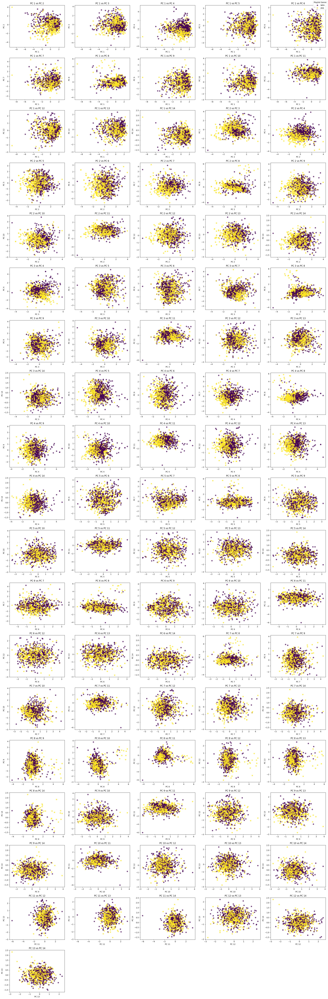

In [ ]:
import math

pc_pairs = [(i, j) for i in range(component_count) for j in range(i+1, component_count)]
cols = 5
rows = math.ceil(len(pc_pairs) / cols)

fig, axes = plt.subplots(rows, cols, figsize=(5*cols, 4*rows))
axes = axes.flatten()

y_colors = y_encoded
genre_labels = genre_encoder.classes_

for idx, (c1, c2) in enumerate(pc_pairs):
    ax = axes[idx]
    scatter = ax.scatter(
        X_pca[:, c1],
        X_pca[:, c2],
        c=y_colors,
        cmap="viridis",
        alpha=0.7
    )
    ax.set_xlabel(f"PC {c1+1}")
    ax.set_ylabel(f"PC {c2+1}")
    ax.set_title(f"PC {c1+1} vs PC {c2+1}")

for j in range(len(pc_pairs), len(axes)):
    fig.delaxes(axes[j])

handles, _ = scatter.legend_elements(prop="colors")
fig.legend(handles, genre_labels, title="Playlist Genre", loc="upper right")

plt.tight_layout()
plt.show()


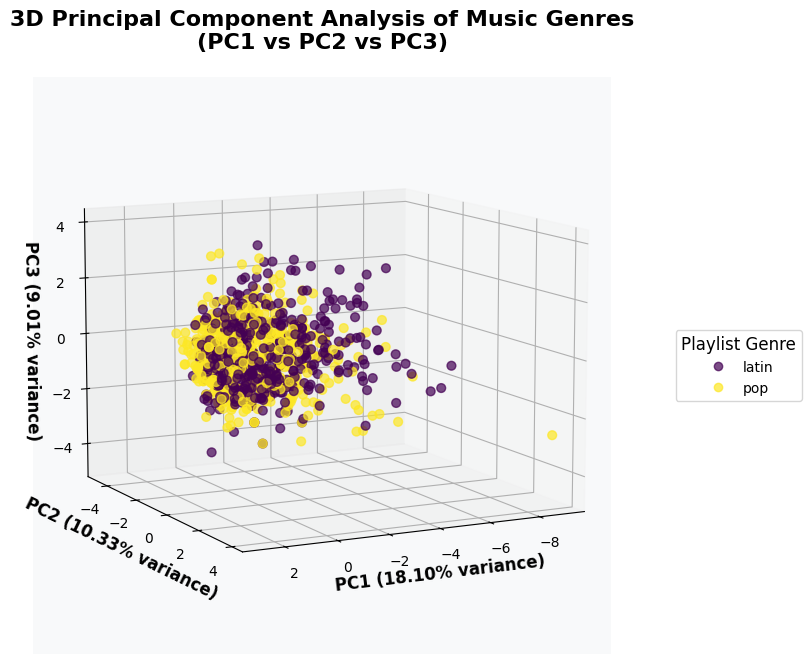

Principal Component Variance Explained:
PC1: 18.099%
PC2: 10.333%
PC3: 9.012%
Total variance explained by first 3 PCs: 37.444%


In [ ]:
fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection='3d')

scatter = ax.scatter3D(
    X_pca[:, 0],
    X_pca[:, 1],
    X_pca[:, 2],
    c=y_colors,
    cmap="viridis",
    alpha=0.7,
    s=40,
    depthshade=True
)

ax.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.2%} variance)', fontsize=12, fontweight='bold')
ax.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.2%} variance)', fontsize=12, fontweight='bold')
ax.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]:.2%} variance)', fontsize=12, fontweight='bold')

ax.set_title('3D Principal Component Analysis of Music Genres\n(PC1 vs PC2 vs PC3)',
             fontsize=16, fontweight='bold', pad=20)

handles, _ = scatter.legend_elements(prop="colors")
legend = ax.legend(handles, genre_labels,
                  title="Playlist Genre",
                  title_fontsize=12,
                  loc='center left',
                  bbox_to_anchor=(1.1, 0.5),
                  fontsize=10)

ax.view_init(elev=10, azim=63)

ax.grid(True, alpha=0.3)

ax.set_facecolor('#F8F9FA')
fig.patch.set_facecolor('white')

plt.tight_layout()
plt.show()

print("Principal Component Variance Explained:")
print("=" * 40)
print(f"PC1: {pca.explained_variance_ratio_[0]:.3%}")
print(f"PC2: {pca.explained_variance_ratio_[1]:.3%}")
print(f"PC3: {pca.explained_variance_ratio_[2]:.3%}")
print(f"Total variance explained by first 3 PCs: {pca.explained_variance_ratio_[:3].sum():.3%}")